In [1]:
from datamaker_f import VideoDataGenerator, VideoDataGenerator2
from pipeline_f import build_full_model
import pickle
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from io import BytesIO
from PIL import Image
import pandas as pd
import numpy as np
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import EarlyStopping

In [2]:
from tensorflow.keras.models import load_model

In [3]:
# Load the dataset from the pickle file
with open("D:/Projects/Face-Swap-Detection-Model/video_data_df_lq_16K.pkl", "rb") as f:
    pickled_data = pickle.load(f)


In [4]:
video_names, labels = zip(*[
    (video_name, video_info['frame_label'][0])
    for video_name, video_info in pickled_data.items()
    if 'frame_label' in video_info and len(video_info['frame_label']) > 0
])


In [5]:
# Split the data
train_names, test_names, train_labels, test_labels = train_test_split(video_names, labels, test_size=0.3, random_state=42)
train_names, val_names, train_labels, val_labels = train_test_split(train_names, train_labels, test_size=0.2, random_state=44)

In [6]:
# Prepare dictionaries for each split
train_data = {name: pickled_data[name] for name in train_names}
val_data = {name: pickled_data[name] for name in val_names}
test_data = {name: pickled_data[name] for name in test_names}

In [7]:
# Define the output signature for the generator
output_signature = (
    (
        tf.TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32),
        tf.TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32)
    ),
    tf.TensorSpec(shape=(None,1), dtype=tf.float32)
)

train_generator = tf.data.Dataset.from_generator(
    lambda: VideoDataGenerator(train_data),
    output_signature=output_signature
)


val_generator = tf.data.Dataset.from_generator(
    lambda: VideoDataGenerator(val_data),
    output_signature=output_signature
)

test_generator = tf.data.Dataset.from_generator(
    lambda: VideoDataGenerator(test_data),
    output_signature=output_signature
)

In [8]:
model_lqdf  = load_model("lq_model_dff_acc_9560_250225.h5")

In [ ]:
import psutil
import time

# Function to monitor RAM usage
def monitor_memory():
    process = psutil.Process()
    mem_usage = process.memory_info().rss / 1024**2  # Convert to MB
    print(f"RAM Usage: {mem_usage:.2f} MB")

# Before model prediction
monitor_memory()

# Run model inference
y_pred = model_lqdf.predict(test_generator)

# After model prediction
monitor_memory()


RAM Usage: 6956.81 MB
300/300 [==============================] - 192s 627ms/step
RAM Usage: 7178.49 MB


In [10]:
class MemoryUsageCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        process = psutil.Process()
        mem_usage = process.memory_info().rss / 1024**2  # Convert to MB
        print(f"Epoch {epoch+1}: RAM Usage = {mem_usage:.2f} MB")

In [10]:
small_train_data = train_generator.take(10)

In [2]:
model_eval = build_full_model()

In [18]:
optimizer = Adam(learning_rate=1e-4)

In [19]:
model_eval.compile(
    optimizer=optimizer,
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

In [20]:
print(f"Before Training memory usage: {monitor_memory()}")

RAM Usage: 1391.30 MB
Before Training memory usage: None


In [24]:
# Train with memory tracking callback on small dataset
model_eval.fit(small_train_data, epochs=5, callbacks=[MemoryUsageCallback()])

Epoch 1/5
     10/Unknown - 22s 2s/step - loss: 0.7216 - accuracy: 0.6313Epoch 1: RAM Usage = 3600.36 MB
10/10 [==============================] - 22s 2s/step - loss: 0.7216 - accuracy: 0.6313
Epoch 2/5
10/10 [==============================] - 21s 2s/step - loss: 0.6790 - accuracy: 0.6687
Epoch 3/5
10/10 [==============================] - 21s 2s/step - loss: 0.7312 - accuracy: 0.6938
Epoch 4/5
10/10 [==============================] - 21s 2s/step - loss: 0.5715 - accuracy: 0.7688
Epoch 5/5
10/10 [==============================] - 21s 2s/step - loss: 0.5468 - accuracy: 0.7875


In [1]:
model.save("model.h5")  # Save the model
import os
size = os.path.getsize("lq_model_dff_acc_9560_250225.h5") / (1024**2)  # Convert to MB
print(f"Model Size: {size:.2f} MB")


NameError: name 'model' is not defined

In [28]:
model.evaluate(test_generator)

300/300 [==============================] - 191s 620ms/step - loss: 0.2305 - accuracy: 0.9560


[0.23045359551906586, 0.956041693687439]

##  **Tception Model Inference Speed Testing**

In [13]:
import tensorflow as tf
import numpy as np
import time

# Load Two Xception Networks
stream1_model = tf.keras.applications.Xception(weights='imagenet')
stream2_model = tf.keras.applications.Xception(weights='imagenet')

# Create two random input tensors (batch size = 1, 299x299x3)
input_data1 = np.random.rand(1, 299, 299, 3).astype(np.float32)
input_data2 = np.random.rand(1, 299, 299, 3).astype(np.float32)

# Measure inference time for parallel execution
num_runs = 100  # Adjust for better averaging
times = []

for _ in range(num_runs):
    start_time = time.time()
    
    # Run both streams in parallel
    preds1 = stream1_model.predict(input_data1)
    preds2 = stream2_model.predict(input_data2)

    # Fuse outputs (Example: average fusion)
    final_output = (preds1 + preds2) / 2  

    end_time = time.time()
    times.append((end_time - start_time) * 1000)  # Convert to ms

# Compute average inference time
avg_time = sum(times) / len(times)
print(f"Two-Stream Xception Average Inference Time: {avg_time:.2f} ms")

1/1 [==============================] - 0s 126ms/step
Two-Stream Xception Average Inference Time: 351.64 ms


In [12]:
import tensorflow as tf
import numpy as np
import time
import threading
import os

# Force TensorFlow to use CPU only (optional)
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

# Load Two Xception Networks
stream1_model = tf.keras.applications.Xception(weights='imagenet')
stream2_model = tf.keras.applications.Xception(weights='imagenet')

# Define batch parameters
videos_per_batch = 16
frames_per_video = 10
batch_size = videos_per_batch * frames_per_video

# Generate dummy batches
input_data1 = np.random.rand(batch_size, 299, 299, 3).astype(np.float32)
input_data2 = np.random.rand(batch_size, 299, 299, 3).astype(np.float32)

# Preprocess input to [-1, 1] range
input_data1 = tf.keras.applications.xception.preprocess_input(input_data1)
input_data2 = tf.keras.applications.xception.preprocess_input(input_data2)

# Storage for results
results = [None, None]

# Define inference function
def predict_stream(model, input_data, index):
    results[index] = model.predict(input_data)

# Measure inference time
num_runs = 10
times = []

for _ in range(num_runs):
    start_time = time.time()

    # Create two threads
    t1 = threading.Thread(target=predict_stream, args=(stream1_model, input_data1, 0))
    t2 = threading.Thread(target=predict_stream, args=(stream2_model, input_data2, 1))

    # Start threads
    t1.start()
    t2.start()

    # Wait for both threads to finish
    t1.join()
    t2.join()

    # Fuse outputs (example: average fusion)
    final_output = (results[0] + results[1]) / 2  

    end_time = time.time()
    times.append((end_time - start_time) * 1000)  # milliseconds

# Compute averages
avg_time_per_batch = sum(times) / len(times)
avg_time_per_frame = avg_time_per_batch / batch_size
avg_time_per_video = avg_time_per_batch / videos_per_batch

# Print results
print(f"Parallel Two-Stream Xception Average Inference Time per Batch ({batch_size} frames): {avg_time_per_batch:.2f} ms")
print(f"Average Inference Time per Frame: {avg_time_per_frame:.2f} ms")
print(f"Average Inference Time per Video (16 videos per batch): {avg_time_per_video:.2f} ms")


5/5 [==============================] - 36s 7s/step
Parallel Two-Stream Xception Average Inference Time per Batch (160 frames): 37125.01 ms
Average Inference Time per Frame: 232.03 ms
Average Inference Time per Video (16 videos per batch): 2320.31 ms


## **Inference Speed Testing For Single Xception Model**

In [10]:
import tensorflow as tf
import numpy as np
import time
import os

# Force TensorFlow to use CPU only
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

# Load Xception model
model = tf.keras.applications.Xception(weights='imagenet')

# Define batch parameters
videos_per_batch = 16  # Each batch contains frames from 16 videos
frames_per_video = 10  # Number of frames per video (adjust as needed)
batch_size = videos_per_batch * frames_per_video  # Total frames per batch

# Generate a batch of dummy frames (299x299x3)
input_data = np.random.rand(batch_size, 299, 299, 3).astype(np.float32)

# Normalize input to [-1, 1] range (Xception preprocessing)
input_data = tf.keras.applications.xception.preprocess_input(input_data)

# Run inference multiple times to get an accurate measurement
num_runs = 10
times = []

for _ in range(num_runs):
    start_time = time.time()
    _ = model.predict(input_data)  # Run inference on the batch
    end_time = time.time()
    times.append((end_time - start_time) * 1000)  # Convert to milliseconds

# Compute average inference time
avg_time_per_batch = sum(times) / len(times)
avg_time_per_frame = avg_time_per_batch / batch_size  # Time per frame
avg_time_per_video = avg_time_per_batch / videos_per_batch  # Time per video

# Print results
print(f"Average Inference Time per Batch ({batch_size} frames): {avg_time_per_batch:.2f} ms")
print(f"Average Inference Time per Frame: {avg_time_per_frame:.2f} ms")
print(f"Average Inference Time per Video (16 videos per batch): {avg_time_per_video:.2f} ms")


5/5 [==============================] - 19s 4s/step
Average Inference Time per Batch (160 frames): 18501.92 ms
Average Inference Time per Frame: 115.64 ms
Average Inference Time per Video (16 videos per batch): 1156.37 ms


In [11]:
total_facial_frames = 0
total_microexp_frames = 0

for (facial_frames, microexp_frames), labels in test_generator:
    total_facial_frames += facial_frames.shape[0]
    total_microexp_frames += microexp_frames.shape[0]

total_frames = total_facial_frames + total_microexp_frames

print(f"Total Facial Frames: {total_facial_frames}")
print(f"Total Micro-Expression Frames: {total_microexp_frames}")
print(f"Total Frames (Facial + Micro-Exp): {total_frames}")


Total Facial Frames: 4800
Total Micro-Expression Frames: 4800
Total Frames (Facial + Micro-Exp): 9600


In [12]:
def count_frames(acc, batch):
    facial_frames, microexp_frames = batch[0]
    return acc + tf.shape(facial_frames)[0] + tf.shape(microexp_frames)[0]

total_frames = test_generator.reduce(tf.constant(0, dtype=tf.int32), count_frames)

print(f"Total Frames (Facial + Micro-Exp): {total_frames.numpy()}")


Total Frames (Facial + Micro-Exp): 9600


In [14]:
import numpy as np

def count_classes_tf_dataset(dataset):
    counts = {}
    
    for batch_X, batch_y in dataset:
        # Convert batch_y to numpy for counting
        batch_y = batch_y.numpy()
        unique, counts_batch = np.unique(batch_y, return_counts=True)
        for u, c in zip(unique, counts_batch):
            counts[u] = counts.get(u, 0) + c
    
    return counts

# Example for train, val, and test datasets
train_counts = count_classes_tf_dataset(train_generator)
val_counts = count_classes_tf_dataset(val_generator)
test_counts = count_classes_tf_dataset(test_generator)

# Print the results
print("Training Data Distribution:", train_counts)
print("Validation Data Distribution:", val_counts)
print("Testing Data Distribution:", test_counts)


Training Data Distribution: {0.0: 4447, 1.0: 4512}
Validation Data Distribution: {0.0: 1141, 1.0: 1099}
Testing Data Distribution: {0.0: 2412, 1.0: 2388}


In [15]:
model.predict(test_generator)

300/300 [==============================] - 190s 623ms/step


array([[1.0000000e+00],
       [9.8719609e-01],
       [2.0427254e-07],
       ...,
       [1.0000000e+00],
       [9.9998426e-01],
       [9.9999797e-01]], dtype=float32)

In [3]:
model_eval.summary()

Model: "full_model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 input_8 (InputLayer)        [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 spatial_feature_extractor   (None, 2048)                 2358771   ['input_7[0][0]']             
 (Functional)                                             2                                       
                                                                                                  
 micro_exp_spatial_feature_  (None, 128)                  2224448   ['input_8[0][0]']    

In [22]:
import tensorflow as tf

def estimate_flops(model):
    total_flops = 0
    for layer in model.layers:
        if isinstance(layer, tf.keras.layers.Conv2D):
            # FLOPs = kernel_height * kernel_width * input_channels * output_channels * output_height * output_width
            flops = (
                layer.kernel_size[0] * layer.kernel_size[1] *
                layer.input_shape[-1] * layer.filters *
                layer.output_shape[1] * layer.output_shape[2]
            )
            total_flops += flops

        elif isinstance(layer, tf.keras.layers.Dense):
            # FLOPs = input_features * output_features
            flops = layer.input_shape[-1] * layer.units
            total_flops += flops

        elif isinstance(layer, tf.keras.layers.LSTM) or isinstance(layer, tf.keras.layers.Bidirectional):
            # Handling LSTM and BiLSTM
            units = layer.units if isinstance(layer, tf.keras.layers.LSTM) else layer.forward_layer.units
            input_size = layer.input_shape[-1]
            timesteps = layer.input_shape[1]

            # LSTM FLOPs per timestep
            lstm_flops = 4 * (input_size + units) * units

            # Total FLOPs for sequence processing
            total_flops += lstm_flops * timesteps

    return total_flops

resnet50_flops = 3.8 * (10**9)  # Convert to FLOPs
total_flops = estimate_flops(model_lqdf) + resnet50_flops
print(f"Estimated FLOPs: {total_flops / 1e9} GFLOPs")



Estimated FLOPs: 3.800663616 GFLOPs


## **GFLOPs Calculation**

In [23]:
model = build_full_model()

In [26]:
import tensorflow as tf

# Assume your model is already created:
# Example:
# full_model = tf.keras.Model(inputs=[input1, input2], outputs=output)

# Create dummy inputs matching your model's input shapes
input1 = tf.random.uniform((1, 224, 224, 3))
input2 = tf.random.uniform((1, 64, 64, 3))

# Wrap the model with tf.function and get a concrete function
full_model_func = tf.function(model).get_concrete_function(
    [tf.TensorSpec(input1.shape, input1.dtype),
     tf.TensorSpec(input2.shape, input2.dtype)]
)

# Get FLOPs using tf.profiler
from tensorflow.python.framework.convert_to_constants import convert_variables_to_constants_v2

# Convert model function to frozen graph
frozen_func = convert_variables_to_constants_v2(full_model_func)
graph_def = frozen_func.graph.as_graph_def()

# Calculate FLOPs
with tf.Graph().as_default() as graph:
    tf.compat.v1.import_graph_def(graph_def, name="")
    run_meta = tf.compat.v1.RunMetadata()
    opts = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()

    flops = tf.compat.v1.profiler.profile(
        graph=graph,
        run_meta=run_meta,
        cmd='op',
        options=opts
    )

    if flops is not None:
        total_flops = flops.total_float_ops
        print(f"Total FLOPs: {total_flops}")
        print(f"Total GFLOPs: {total_flops / 1e9:.3f} GFLOPs")
    else:
        print("Failed to calculate FLOPs.")




Total FLOPs: 7818719937
Total GFLOPs: 7.819 GFLOPs


In [19]:
model.input_shape

[(None, 224, 224, 3), (None, 64, 64, 3)]

In [27]:
model.summary()

Model: "full_model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_56 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 input_57 (InputLayer)       [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 spatial_feature_extractor   (None, 2048)                 2358771   ['input_56[0][0]']            
 (Functional)                                             2                                       
                                                                                                  
 micro_exp_spatial_feature_  (None, 128)                  2224448   ['input_57[0][0]']   

In [10]:
model_lqdf.layers

In [11]:
for i, layer in enumerate(model_lqdf.layers):
    print(f"{i}: {layer.name} - {layer.__class__.__name__} - {layer.output_shape}")


0: input_7 - InputLayer - [(None, 224, 224, 3)]
1: input_8 - InputLayer - [(None, 64, 64, 3)]
2: spatial_feature_extractor - Functional - (None, 2048)
3: micro_exp_spatial_feature_extractor - Functional - (None, 128)
4: lambda_2 - Lambda - (None, 1, 2048)
5: lambda_4 - Lambda - (None, 1, 128)
6: lambda_6 - Lambda - (None, 1, 2048)
7: lambda_3 - Lambda - (None, 30, 2048)
8: lambda_8 - Lambda - (None, 1, 128)
9: lambda_5 - Lambda - (None, 30, 128)
10: lambda_7 - Lambda - (None, 30, 2048)
11: temporal_feature_extractor - Functional - (None, 30, 128)
12: lambda_9 - Lambda - (None, 30, 128)
13: micro_exp_temporal_feature_extractor - Functional - (None, 30, 128)
14: concatenate - Concatenate - (None, 30, 2432)
15: global_average_pooling1d - GlobalAveragePooling1D - (None, 2432)
16: dense_2 - Dense - (None, 256)
17: dropout_4 - Dropout - (None, 256)
18: dense_3 - Dense - (None, 128)
19: dropout_5 - Dropout - (None, 128)
20: dense_4 - Dense - (None, 64)
21: dropout_6 - Dropout - (None, 64)
22:

In [12]:
model_lqdf.summary()

Model: "full_model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 input_8 (InputLayer)        [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 spatial_feature_extractor   (None, 2048)                 2358771   ['input_7[0][0]']             
 (Functional)                                             2                                       
                                                                                                  
 micro_exp_spatial_feature_  (None, 128)                  2224448   ['input_8[0][0]']    

In [9]:
model = build_full_model()

In [9]:
from keras.utils import plot_model

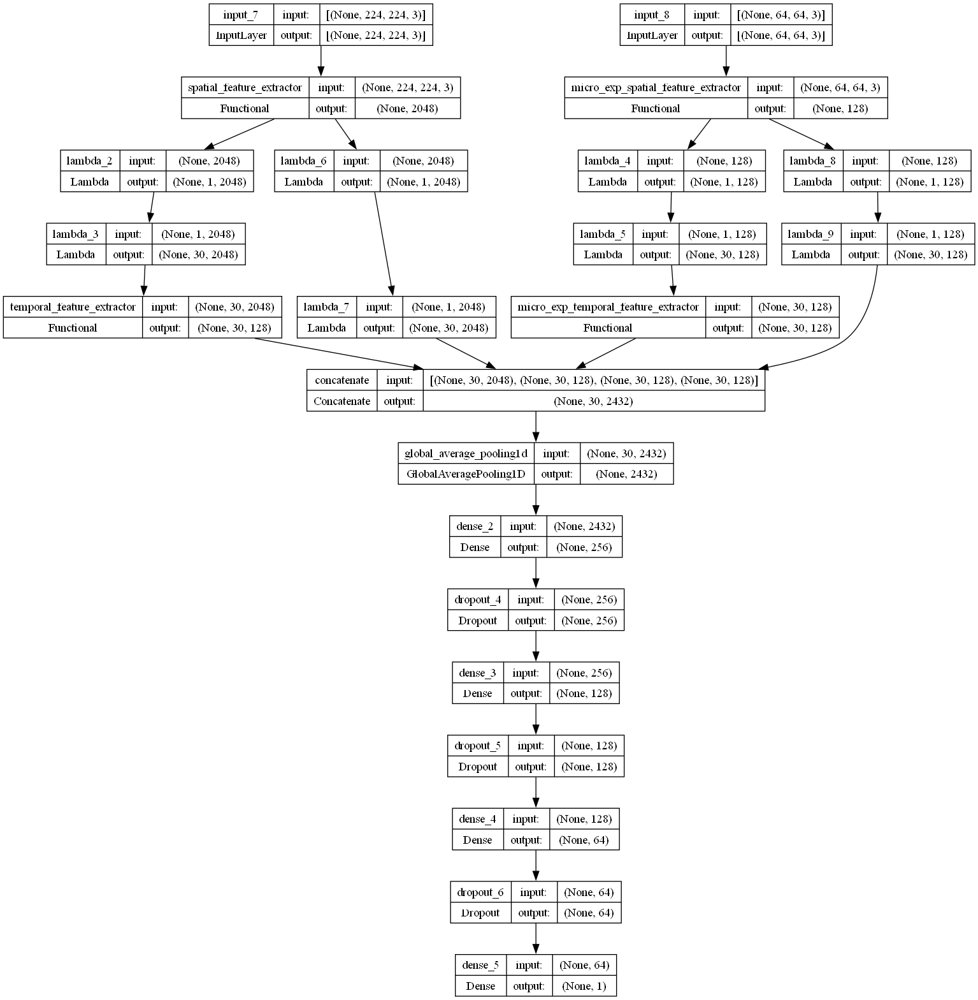

In [10]:
import pydot
from keras.utils import plot_model

# Your model definition
# model = ...

# Attempt to plot the model
plot_model(model, to_file='model.png', show_shapes=True)


In [25]:
for layer in model.layers:
    if isinstance(layer, tf.keras.Model):  # it's a nested model
        print(f"\nSub-model: {layer.name}")
        for sub_layer in layer.layers:
            if isinstance(sub_layer, tf.keras.layers.Conv2D):
                print(f"  {sub_layer.name} — {sub_layer.output_shape}")
    elif isinstance(layer, tf.keras.layers.Conv2D):
        print(f"Top-level Conv2D: {layer.name} — {layer.output_shape}")



Sub-model: spatial_feature_extractor
  conv1_conv — (None, 112, 112, 64)
  conv2_block1_1_conv — (None, 56, 56, 64)
  conv2_block1_2_conv — (None, 56, 56, 64)
  conv2_block1_0_conv — (None, 56, 56, 256)
  conv2_block1_3_conv — (None, 56, 56, 256)
  conv2_block2_1_conv — (None, 56, 56, 64)
  conv2_block2_2_conv — (None, 56, 56, 64)
  conv2_block2_3_conv — (None, 56, 56, 256)
  conv2_block3_1_conv — (None, 56, 56, 64)
  conv2_block3_2_conv — (None, 56, 56, 64)
  conv2_block3_3_conv — (None, 56, 56, 256)
  conv3_block1_1_conv — (None, 28, 28, 128)
  conv3_block1_2_conv — (None, 28, 28, 128)
  conv3_block1_0_conv — (None, 28, 28, 512)
  conv3_block1_3_conv — (None, 28, 28, 512)
  conv3_block2_1_conv — (None, 28, 28, 128)
  conv3_block2_2_conv — (None, 28, 28, 128)
  conv3_block2_3_conv — (None, 28, 28, 512)
  conv3_block3_1_conv — (None, 28, 28, 128)
  conv3_block3_2_conv — (None, 28, 28, 128)
  conv3_block3_3_conv — (None, 28, 28, 512)
  conv3_block4_1_conv — (None, 28, 28, 128)
  conv3_

In [ ]:
last_conv_layer = model.get_layer("micro_exp_spatial_feature_extractor").get_layer("micro_exp_last_conv")


In [30]:
print(last_conv_layer)

In [48]:
print(model.get_layer("spatial_feature_extractor").get_layer("conv1_pad").output)


KerasTensor(type_spec=TensorSpec(shape=(None, 230, 230, 3), dtype=tf.float32, name=None), name='conv1_pad/Pad:0', description="created by layer 'conv1_pad'")


In [66]:
%pip install tf-explain

Note: you may need to restart the kernel to use updated packages.


In [9]:
model = build_full_model()

In [10]:
model.summary()

Model: "full_model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 input_8 (InputLayer)        [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 spatial_feature_extractor   (None, 2048)                 2358771   ['input_7[0][0]']             
 (Functional)                                             2                                       
                                                                                                  
 micro_exp_spatial_feature_  (None, 128)                  2224448   ['input_8[0][0]']    

In [11]:
for layer in model.layers:
    if isinstance(layer, tf.keras.Model):  # it's a nested model
        print(f"\nSub-model: {layer.name}")
        for sub_layer in layer.layers:
            if isinstance(sub_layer, tf.keras.layers.Conv2D):
                print(f"  {sub_layer.name} — {sub_layer.output_shape}")
    elif isinstance(layer, tf.keras.layers.Conv2D):
        print(f"Top-level Conv2D: {layer.name} — {layer.output_shape}")



Sub-model: spatial_feature_extractor
  conv1_conv — (None, 112, 112, 64)
  conv2_block1_1_conv — (None, 56, 56, 64)
  conv2_block1_2_conv — (None, 56, 56, 64)
  conv2_block1_0_conv — (None, 56, 56, 256)
  conv2_block1_3_conv — (None, 56, 56, 256)
  conv2_block2_1_conv — (None, 56, 56, 64)
  conv2_block2_2_conv — (None, 56, 56, 64)
  conv2_block2_3_conv — (None, 56, 56, 256)
  conv2_block3_1_conv — (None, 56, 56, 64)
  conv2_block3_2_conv — (None, 56, 56, 64)
  conv2_block3_3_conv — (None, 56, 56, 256)
  conv3_block1_1_conv — (None, 28, 28, 128)
  conv3_block1_2_conv — (None, 28, 28, 128)
  conv3_block1_0_conv — (None, 28, 28, 512)
  conv3_block1_3_conv — (None, 28, 28, 512)
  conv3_block2_1_conv — (None, 28, 28, 128)
  conv3_block2_2_conv — (None, 28, 28, 128)
  conv3_block2_3_conv — (None, 28, 28, 512)
  conv3_block3_1_conv — (None, 28, 28, 128)
  conv3_block3_2_conv — (None, 28, 28, 128)
  conv3_block3_3_conv — (None, 28, 28, 512)
  conv3_block4_1_conv — (None, 28, 28, 128)
  conv3_

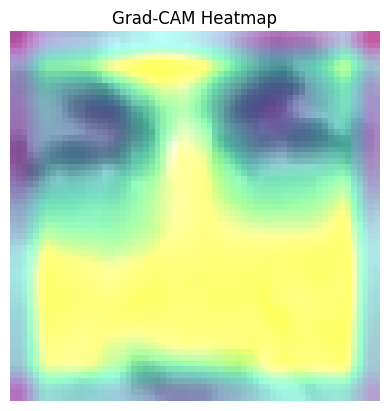

In [12]:
import tensorflow as tf
from tf_explain.core import GradCAM
import numpy as np
import matplotlib.pyplot as plt

# Load and preprocess your input image
img_path = "C:/codes/projects/SIH-2024/DeepFake/DeepFake/Face-Swap-Detection-Model/sample_data/frame_0_full_eye_0.jpg"
img = tf.keras.preprocessing.image.load_img(img_path, target_size=(64, 64))
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array = img_array / 255.0  # Normalize

# Assuming `model` is your trained model
gradcam = GradCAM()

# Apply Grad-CAM
explanation = gradcam.explain((img_array, None), model.get_layer("micro_exp_spatial_feature_extractor"), class_index=None, layer_name=model.get_layer("micro_exp_spatial_feature_extractor").get_layer("micro_exp_last_conv").name)  # Specify the layer name

# Display Grad-CAM heatmap
plt.imshow(explanation)
plt.axis('off')
plt.title("Grad-CAM Heatmap")
plt.show()



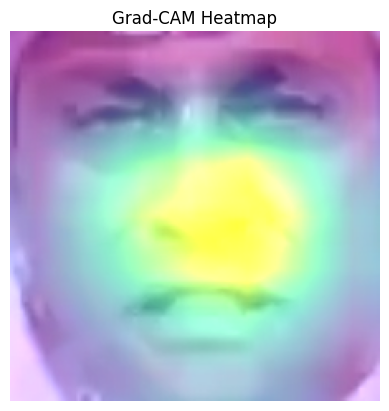

In [13]:
import tensorflow as tf
from tf_explain.core import GradCAM
import numpy as np
import matplotlib.pyplot as plt

# Load and preprocess your input image
img_path = "C:/codes/projects/SIH-2024/DeepFake/DeepFake/Face-Swap-Detection-Model/sample_data/frame_0_face_0.jpg"
img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array = img_array / 255.0  # Normalize

# Assuming `model` is your trained model
gradcam = GradCAM()

# Apply Grad-CAM
explanation = gradcam.explain((img_array, None), model.get_layer("spatial_feature_extractor"), class_index=None, layer_name=model.get_layer("spatial_feature_extractor").get_layer("conv5_block3_3_conv").name)  # Specify the layer name

# Display Grad-CAM heatmap
plt.imshow(explanation)
plt.axis('off')
plt.title("Grad-CAM Heatmap")
plt.show()



In [14]:
model.layers[0]

In [15]:
for layer in model.get_layer("micro_exp_spatial_feature_extractor").layers:
    print(layer.name)


input_4
micro_exp_conv1
batch_normalization
activation
dropout
max_pooling2d
conv2d
batch_normalization_1
activation_1
dropout_1
max_pooling2d_1
micro_exp_last_conv
batch_normalization_2
activation_2
dropout_2
max_pooling2d_2
flatten
dense
dropout_3
dense_1


In [16]:
for layer in model.get_layer("spatial_feature_extractor").layers:
    print(layer.name)


input_3
conv1_pad
conv1_conv
conv1_bn
conv1_relu
pool1_pad
pool1_pool
conv2_block1_1_conv
conv2_block1_1_bn
conv2_block1_1_relu
conv2_block1_2_conv
conv2_block1_2_bn
conv2_block1_2_relu
conv2_block1_0_conv
conv2_block1_3_conv
conv2_block1_0_bn
conv2_block1_3_bn
conv2_block1_add
conv2_block1_out
conv2_block2_1_conv
conv2_block2_1_bn
conv2_block2_1_relu
conv2_block2_2_conv
conv2_block2_2_bn
conv2_block2_2_relu
conv2_block2_3_conv
conv2_block2_3_bn
conv2_block2_add
conv2_block2_out
conv2_block3_1_conv
conv2_block3_1_bn
conv2_block3_1_relu
conv2_block3_2_conv
conv2_block3_2_bn
conv2_block3_2_relu
conv2_block3_3_conv
conv2_block3_3_bn
conv2_block3_add
conv2_block3_out
conv3_block1_1_conv
conv3_block1_1_bn
conv3_block1_1_relu
conv3_block1_2_conv
conv3_block1_2_bn
conv3_block1_2_relu
conv3_block1_0_conv
conv3_block1_3_conv
conv3_block1_0_bn
conv3_block1_3_bn
conv3_block1_add
conv3_block1_out
conv3_block2_1_conv
conv3_block2_1_bn
conv3_block2_1_relu
conv3_block2_2_conv
conv3_block2_2_bn
conv3_

In [56]:
%pip install tf-keras-vis

  Using cached tf_keras_vis-0.8.7-py3-none-any.whl.metadata (10 kB)
  Using cached Deprecated-1.2.18-py2.py3-none-any.whl.metadata (5.7 kB)
Using cached tf_keras_vis-0.8.7-py3-none-any.whl (52 kB)
Using cached Deprecated-1.2.18-py2.py3-none-any.whl (10.0 kB)
Note: you may need to restart the kernel to use updated packages.


In [16]:
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus

In [25]:
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tf_explain.core import GradCAM

def apply_colormap(heatmap, original):
    """
    Apply heatmap to the original image using colormap.
    """
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    original = cv2.cvtColor(original, cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(original, 0.6, heatmap, 0.4, 0)
    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

def apply_gradcam(model, input_dir, layer_name, max_images=10):
    """
    Apply Grad-CAM to visualize doubtful areas in deepfake images.
    """
    gradcam = GradCAM()

    image_files = [
        f for f in os.listdir(input_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ][:max_images]  # Limit to first `max_images`

    n = len(image_files)
    cols = min(n, 5)
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    axes = np.array(axes).reshape(-1)

    for i, filename in enumerate(image_files):
        img_path = os.path.join(input_dir, filename)

        # Load and preprocess image
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
        img_array = tf.keras.preprocessing.image.img_to_array(img)
        img_input = np.expand_dims(img_array, axis=0) / 255.0

        # Predict class for this image
        pred = model.predict(img_input)
        class_index = np.argmax(pred)

        # Generate Grad-CAM heatmap
        explanation = gradcam.explain(
            (img_input, None),
            model,
            class_index=class_index,
            layer_name=layer_name
        )

        # Apply colormap to the original image to highlight suspicious areas
        overlay = apply_colormap(explanation, img_array.astype(np.uint8))

        # Display the image with heatmap overlay
        axes[i].imshow(overlay)
        axes[i].set_title(f"{filename}", fontsize=10)
        axes[i].axis('off')

    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


1/1 [==============================] - 0s 98ms/step


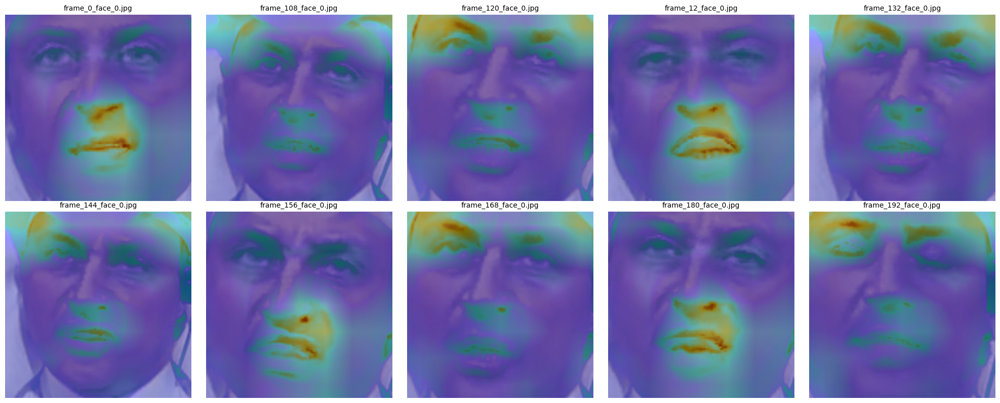

In [26]:
apply_gradcam(model.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/fs/facial/000_003", layer_name="conv5_block3_3_conv")

1/1 [==============================] - 0s 106ms/step


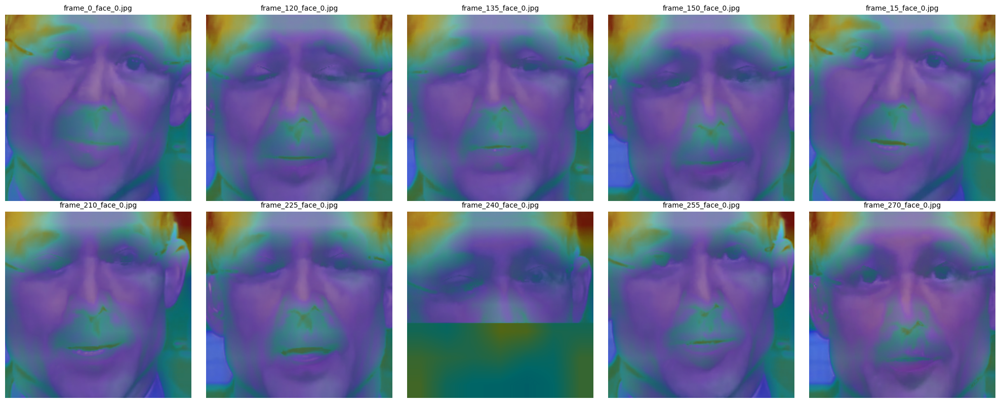

In [19]:

apply_gradcam(model.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/fs/facial/002_006", layer_name="conv5_block3_3_conv")

1/1 [==============================] - 0s 116ms/step


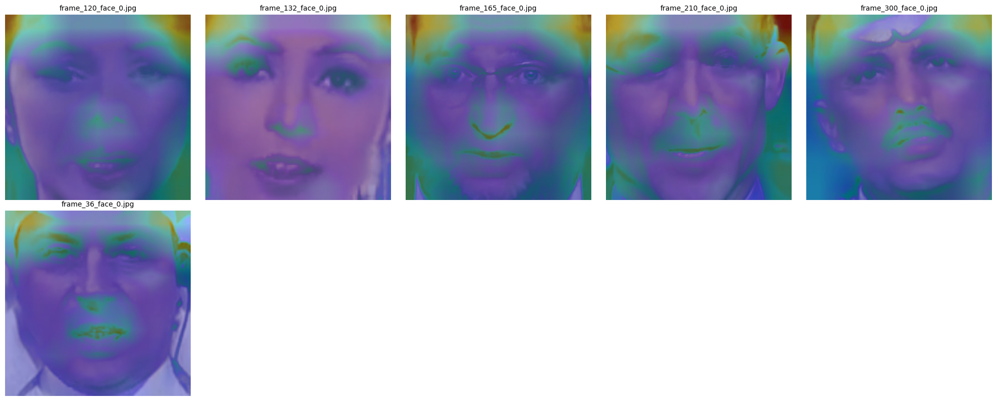

In [20]:
apply_gradcam(model.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/sample_faces", layer_name="conv5_block3_3_conv")

In [21]:
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tf_explain.core import GradCAM

def apply_colormap(heatmap, original):
    """
    Apply heatmap to the original image using colormap.
    """
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    original = cv2.cvtColor(original, cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(original, 0.6, heatmap, 0.4, 0)
    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

def apply_gradcam_me(model, input_dir, layer_name, max_images=10):
    """
    Apply Grad-CAM to visualize doubtful areas in deepfake images.
    """
    gradcam = GradCAM()

    image_files = [
        f for f in os.listdir(input_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ][:max_images]  # Limit to first `max_images`

    n = len(image_files)
    cols = min(n, 5)
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    axes = np.array(axes).reshape(-1)

    for i, filename in enumerate(image_files):
        img_path = os.path.join(input_dir, filename)

        # Load and preprocess image
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=(64, 64))
        img_array = tf.keras.preprocessing.image.img_to_array(img)
        img_input = np.expand_dims(img_array, axis=0) / 255.0

        # Predict class for this image
        pred = model.predict(img_input)
        class_index = np.argmax(pred)

        # Generate Grad-CAM heatmap
        explanation = gradcam.explain(
            (img_input, None),
            model,
            class_index=class_index,
            layer_name=layer_name
        )

        # Apply colormap to the original image to highlight suspicious areas
        overlay = apply_colormap(explanation, img_array.astype(np.uint8))

        # Display the image with heatmap overlay
        axes[i].imshow(overlay)
        axes[i].set_title(f"{filename}", fontsize=10)
        axes[i].axis('off')

    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


1/1 [==============================] - 0s 27ms/step


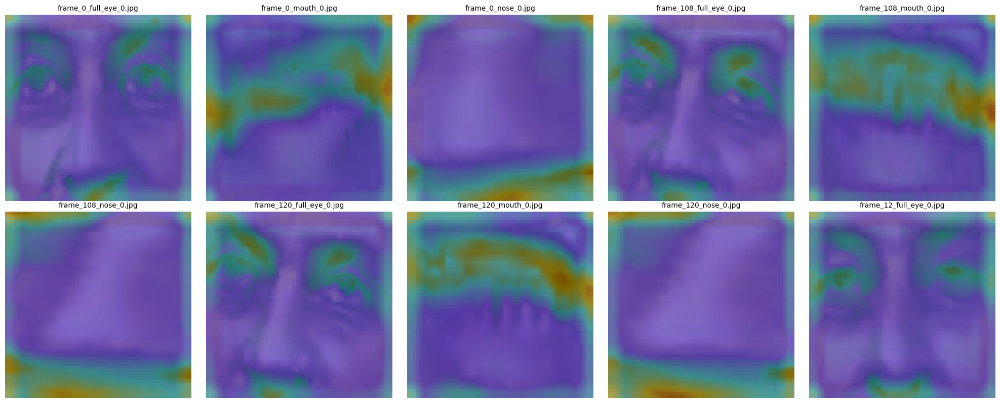

In [22]:
apply_gradcam_me(model.get_layer("micro_exp_spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/fs/micro_expression/000_003", layer_name="micro_exp_last_conv")

1/1 [==============================] - 0s 23ms/step


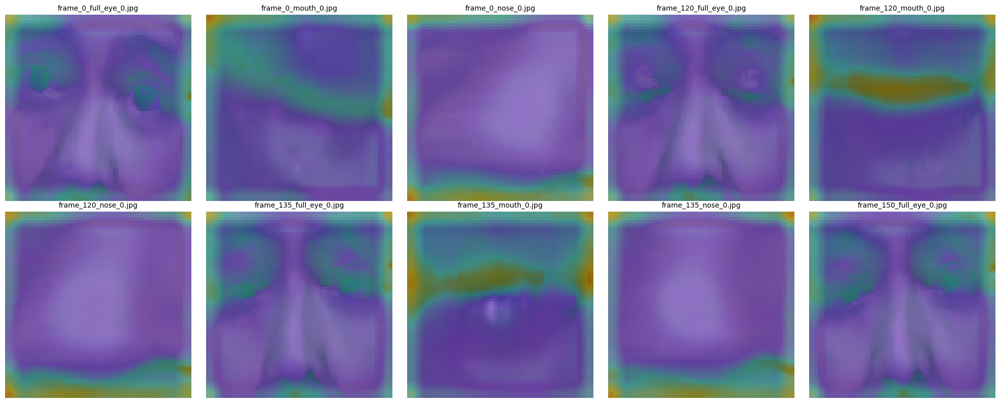

In [23]:
apply_gradcam_me(model.get_layer("micro_exp_spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/fs/micro_expression/002_006", layer_name="micro_exp_last_conv")

In [34]:
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tf_explain.core import GradCAM

def apply_colormap(heatmap, original, alpha=0.4):
    """
    Apply Grad-CAM heatmap on the original image using a smooth colormap.
    """
    # Normalize the heatmap between 0 and 1 as float
    heatmap = np.maximum(heatmap, 0).astype(np.float32)
    heatmap /= np.max(heatmap) + 1e-8  # Avoid division by zero

    # Convert to 0-255 and apply colormap
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.resize(heatmap, (original.shape[1], original.shape[0]), interpolation=cv2.INTER_CUBIC)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Convert original image to BGR for OpenCV overlay
    original_bgr = cv2.cvtColor(original, cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(original_bgr, 1 - alpha, heatmap_color, alpha, 0)

    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

def apply_gradcam_up(model, input_dir, layer_name, target_size=(224, 224), max_images=10):
    """
    Apply Grad-CAM to visualize doubtful areas in deepfake images.
    High-quality and presentation-ready.
    """
    gradcam = GradCAM()

    image_files = [
        f for f in os.listdir(input_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ][:max_images]

    n = len(image_files)
    cols = min(n, 5)
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows), dpi=120)
    axes = np.array(axes).reshape(-1)

    for i, filename in enumerate(image_files):
        img_path = os.path.join(input_dir, filename)

        # Load and preprocess image
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=target_size)
        img_array = tf.keras.preprocessing.image.img_to_array(img)
        img_input = np.expand_dims(img_array, axis=0) / 255.0

        # Predict class for this image
        pred = model.predict(img_input)[0]
        class_index = int(np.argmax(pred))
        confidence = pred[class_index]

        # Generate Grad-CAM heatmap
        explanation = gradcam.explain(
            (img_input, None),
            model,
            class_index=class_index,
            layer_name=layer_name
        )

        # Apply colormap and overlay
        overlay = apply_colormap(explanation, img_array.astype(np.uint8), alpha=0.45)

        # Display the image
        axes[i].imshow(overlay)
        axes[i].set_title(f"{filename}\n", fontsize=9)
        axes[i].axis('off')

    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


1/1 [==============================] - 0s 102ms/step


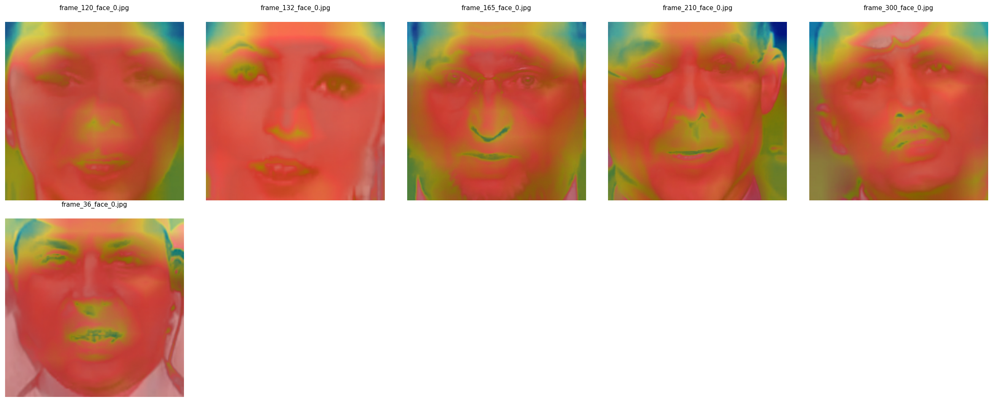

In [35]:
apply_gradcam_up(model.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/sample_faces", layer_name="conv5_block3_3_conv", target_size=(224, 224))

1/1 [==============================] - 0s 29ms/step


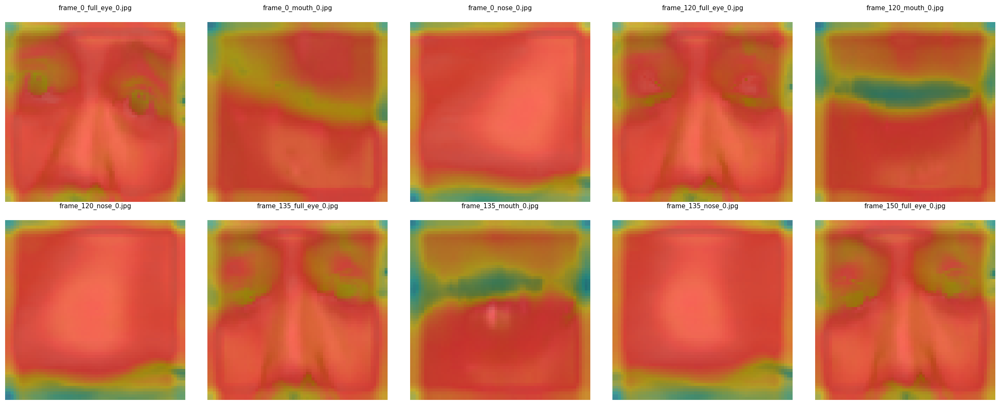

In [38]:
apply_gradcam_up(model.get_layer("micro_exp_spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/fs/micro_expression/002_006", layer_name="micro_exp_last_conv", target_size=(64, 64))

In [10]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tensorflow.keras.models import load_model
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore

def normalize(heatmap):
    """
    Normalize heatmap between 0 and 1 with numerical stability.
    """
    heatmap -= np.min(heatmap)
    heatmap /= (np.max(heatmap) + 1e-8)
    return heatmap

def apply_colormap(heatmap, original, alpha=0.5):
    """
    Overlay heatmap onto the original image using OpenCV.
    """
    heatmap = normalize(heatmap)
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.resize(heatmap, (original.shape[1], original.shape[0]))
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    original_bgr = cv2.cvtColor(original, cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(original_bgr, 1 - alpha, heatmap_color, alpha, 0)

    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

def apply_gradcam_pp_tfvis(model, input_dir, target_layer, target_size=(224, 224), max_images=10):
    """
    Apply GradCAM++ using tf-keras-vis.
    Supports both 224x224 and 64x64 images.
    """
    gradcam = GradcamPlusPlus(model,
                              model_modifier=ReplaceToLinear(),
                              clone=True)

    image_files = [
        f for f in os.listdir(input_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ][:max_images]

    n = len(image_files)
    cols = min(n, 5)
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    axes = np.array(axes).reshape(-1)

    for i, filename in enumerate(image_files):
        img_path = os.path.join(input_dir, filename)

        # Load and preprocess image
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=target_size)
        img_array = tf.keras.preprocessing.image.img_to_array(img)
        img_input = np.expand_dims(img_array, axis=0) / 255.0

        # Predict class
        pred = model.predict(img_input, verbose=0)
        class_index = np.argmax(pred)
        score = CategoricalScore([class_index])

        # Generate heatmap
        cam = gradcam(score, img_input, penultimate_layer=target_layer, seek_penultimate_conv_layer=True)
        heatmap = cam[0]  # (H, W)

        # Apply colormap overlay
        overlay = apply_colormap(heatmap, img_array.astype(np.uint8))

        axes[i].imshow(overlay)
        axes[i].set_title(f"{filename}", fontsize=10)
        axes[i].axis('off')

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

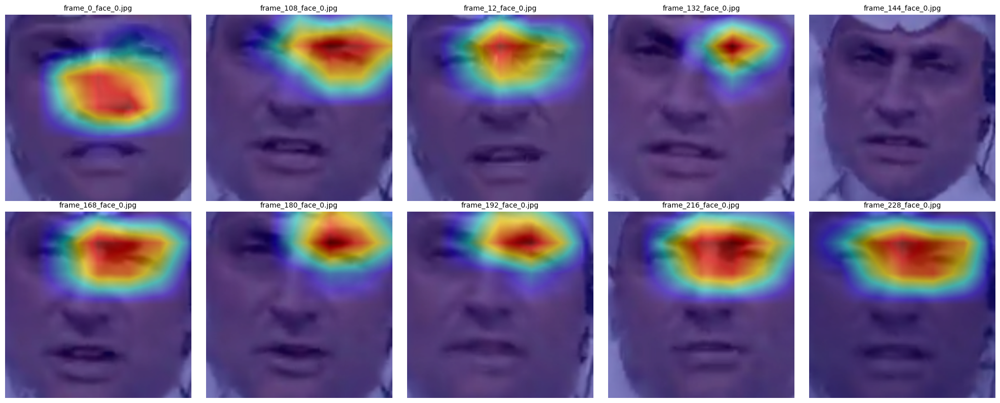

In [31]:
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/000_003", target_layer="conv5_block3_3_conv", target_size=(224, 224))

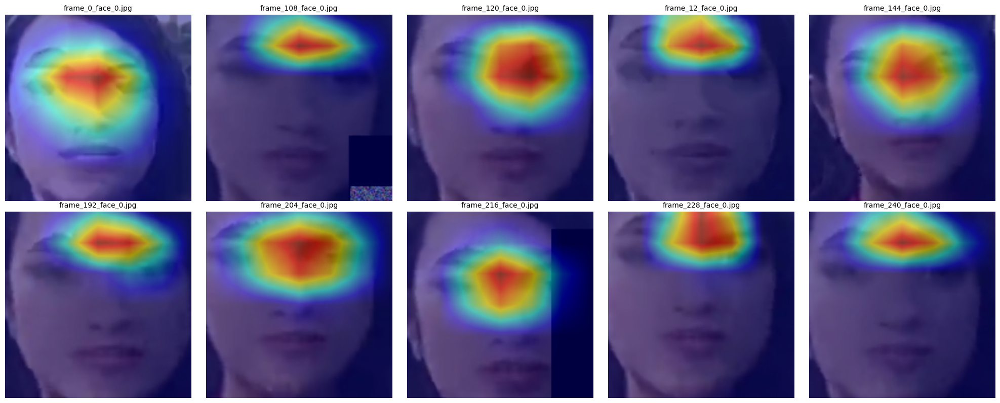

In [32]:
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/001_870", target_layer="conv5_block3_3_conv", target_size=(224, 224))

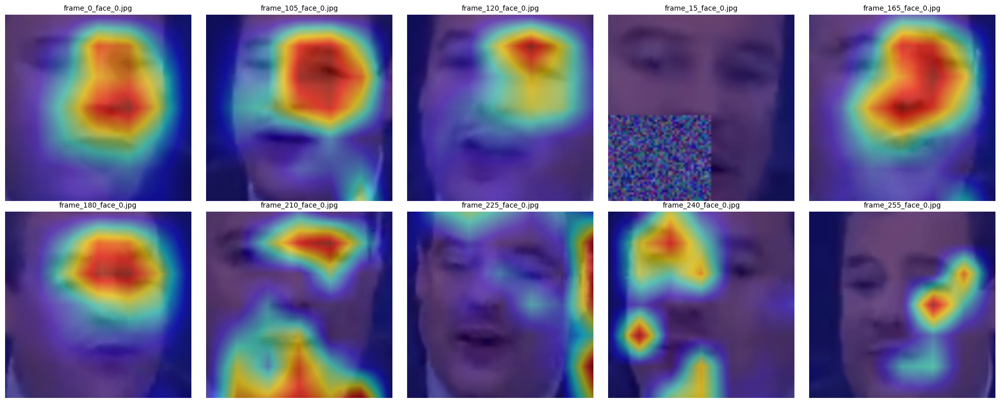

In [33]:
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/015_919", target_layer="conv5_block3_3_conv", target_size=(224, 224))

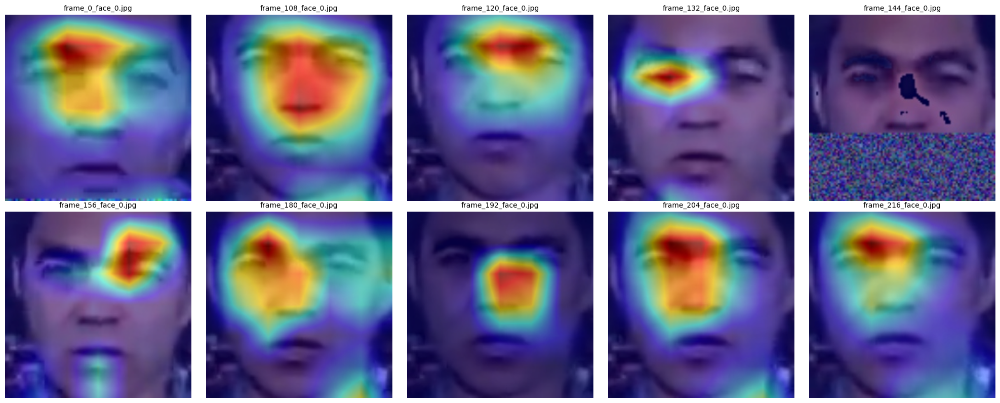

In [34]:
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/023_923", target_layer="conv5_block3_3_conv", target_size=(224, 224))

In [65]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear

# Custom score function
def activation_max_score(model_outputs):
    return tf.reduce_max(model_outputs, axis=1)

# Normalize heatmap with more stability
def normalize_heatmap(heatmap):
    heatmap = np.maximum(heatmap, 0)  # Ensure no negative values
    heatmap -= np.min(heatmap)  # Normalize to [0, 1]
    if np.max(heatmap) != 0:
        heatmap /= np.max(heatmap)
    return heatmap

# Apply colormap and overlay heatmap on image
def overlay_heatmap_on_image(heatmap, image, alpha=0.5):
    heatmap = normalize_heatmap(heatmap)
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[0]))  # Resize heatmap to match image size
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    original = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(original, 1 - alpha, heatmap, alpha, 0)

    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

# Main GradCAM function for micro-expressions
def apply_gradcam_for_micro(model, input_dir, target_layer_name, input_size=(64, 64), max_images=10):
    gradcam = Gradcam(model,
                      model_modifier=ReplaceToLinear(),
                      clone=True)

    image_files = [
        f for f in os.listdir(input_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg'))
    ][:max_images]

    n = len(image_files)
    cols = min(5, n)
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    axes = np.array(axes).reshape(-1)

    for i, filename in enumerate(image_files):
        img_path = os.path.join(input_dir, filename)

        # Load and preprocess the image
        try:
            img = tf.keras.preprocessing.image.load_img(img_path, target_size=input_size)
            img_array = tf.keras.preprocessing.image.img_to_array(img)
            img_input = np.expand_dims(img_array, axis=0) / 255.0
        except Exception as e:
            print(f"Error loading image {filename}: {e}")
            continue

        # Generate GradCAM heatmap
        try:
            cam = gradcam(activation_max_score, img_input, penultimate_layer=target_layer_name)
            heatmap = cam[0]
        except Exception as e:
            print(f"Error generating GradCAM for {filename}: {e}")
            continue

        # Apply overlay on the image
        overlay = overlay_heatmap_on_image(heatmap, img_array.astype(np.uint8))

        # Display the image with the overlay
        axes[i].imshow(overlay)
        axes[i].set_title(filename, fontsize=8)
        axes[i].axis('off')

    # Turn off axes for unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


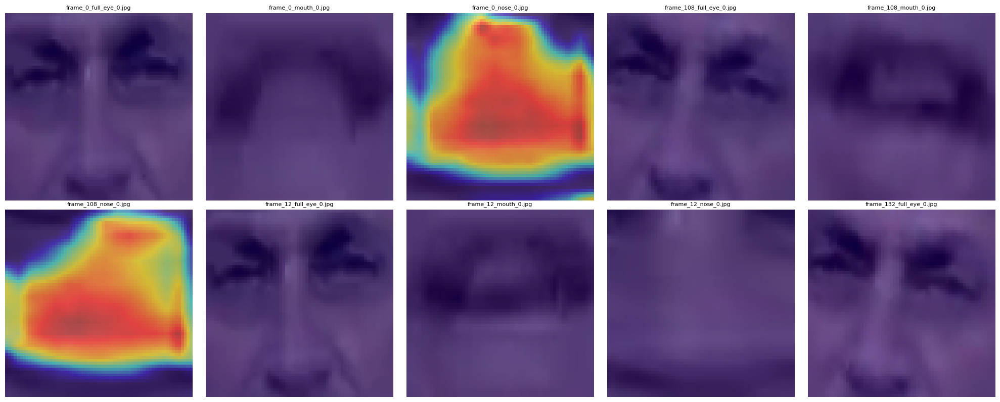

In [69]:
apply_gradcam_for_micro(
    model=model_lqdf.get_layer("micro_exp_spatial_feature_extractor"),
    input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/micro_expression/000_003",
    target_layer_name="conv2d_2",  # your model's layer
    input_size=(64, 64),
    max_images=10
)


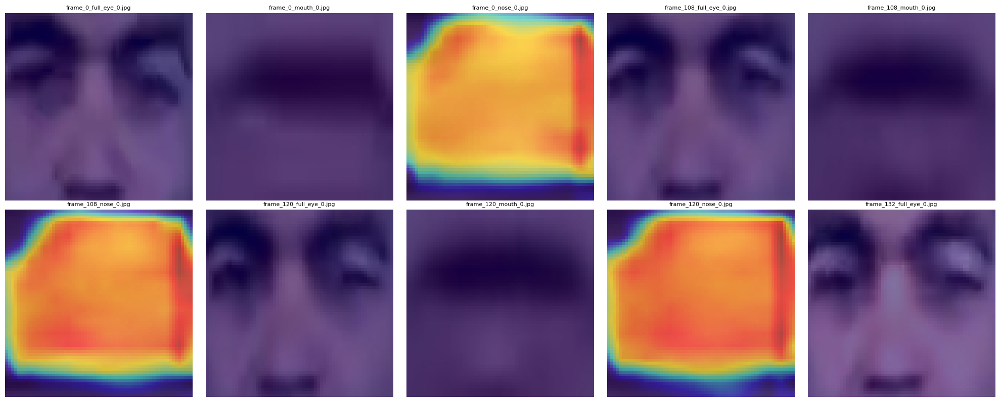

In [67]:
apply_gradcam_for_micro(
    model=model_lqdf.get_layer("micro_exp_spatial_feature_extractor"),
    input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/micro_expression/023_923",
    target_layer_name="conv2d_2",  # your model's layer
    input_size=(64, 64),
    max_images=10
)

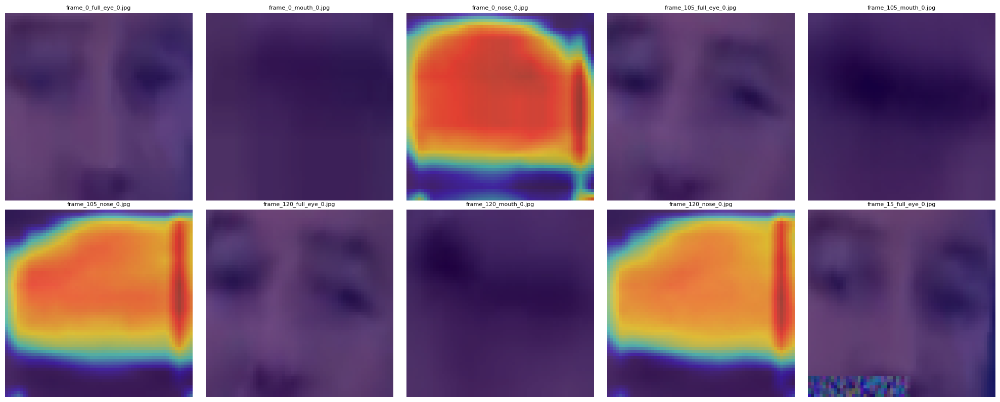

In [53]:
apply_gradcam_for_micro(
    model=model_lqdf.get_layer("micro_exp_spatial_feature_extractor"),
    input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/micro_expression/015_919",
    target_layer_name="conv2d_2",  # your model's layer
    input_size=(64, 64),
    max_images=10
)

In [38]:
model_lqff = load_model("C:/codes/projects/SIH-2024/DeepFake/DeepFake/Face-Swap-Detection-Model/Models/utils/tests/test_1124/lq_model_f2f_acc_9137_210225.h5")

In [79]:
for layer in model_lqff.get_layer("micro_exp_spatial_feature_extractor").layers:
    print(f"{layer.name}")

input_12
conv2d_3
batch_normalization_3
activation_3
dropout_7
max_pooling2d_3
conv2d_4
batch_normalization_4
activation_4
dropout_8
max_pooling2d_4
conv2d_5
batch_normalization_5
activation_5
dropout_9
max_pooling2d_5
flatten_1
dense_6
dropout_10
dense_7


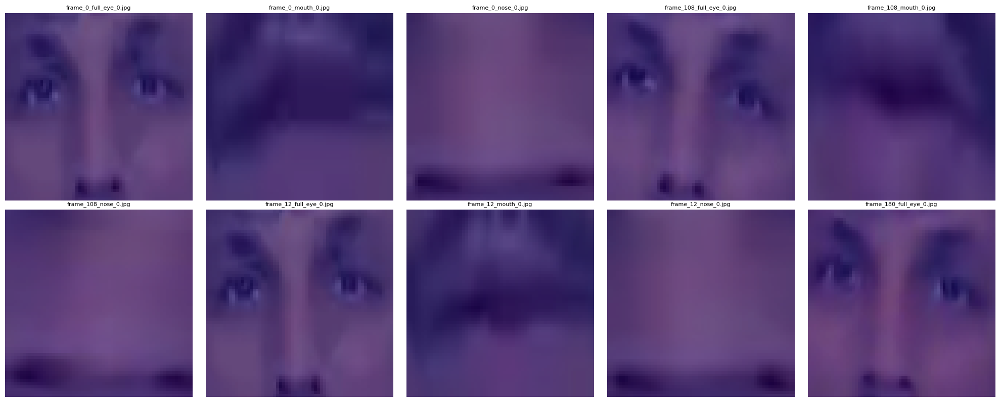

In [77]:
apply_gradcam_for_micro(
    model=model_lqff.get_layer("micro_exp_spatial_feature_extractor"),
    input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/micro_expression/000_003",
    target_layer_name="conv2d_5",  # your model's layer
    input_size=(64, 64),
    max_images=10
)

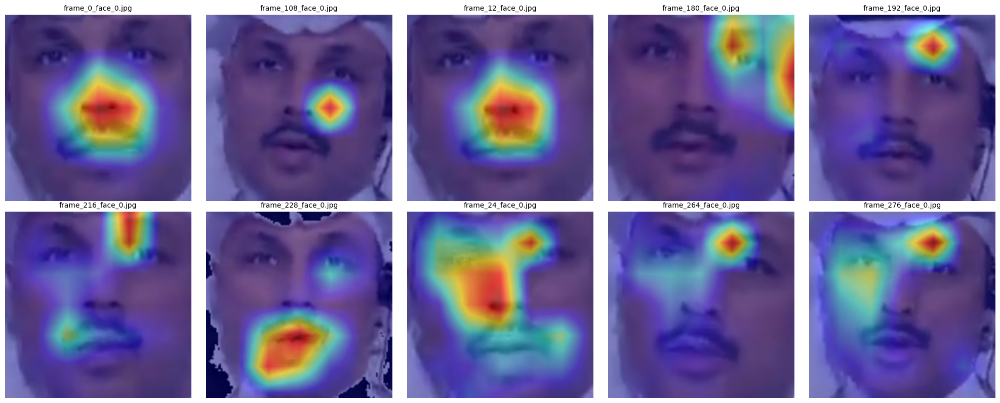

In [82]:
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/000_003", target_layer="conv5_block3_3_conv", target_size=(224, 224))

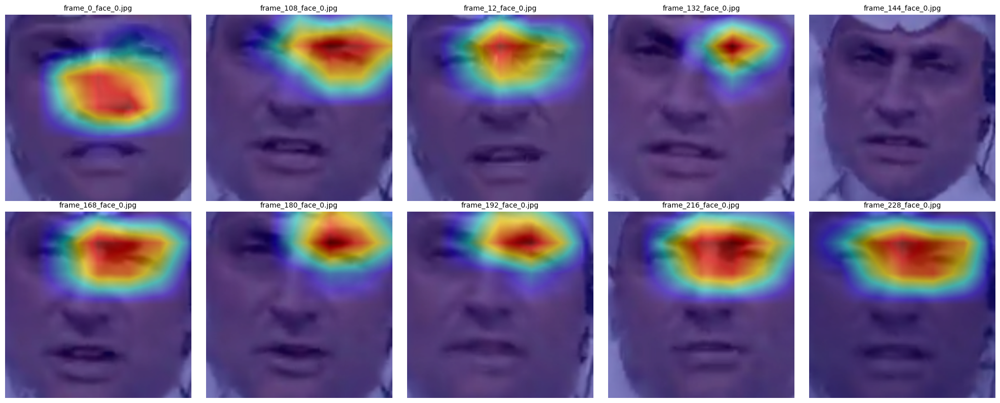

In [83]:
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), input_dir="D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/000_003", target_layer="conv5_block3_3_conv", target_size=(224, 224))

In [58]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
import random

def normalize(heatmap):
    """
    Normalize heatmap between 0 and 1 with numerical stability.
    """
    heatmap -= np.min(heatmap)
    heatmap /= (np.max(heatmap) + 1e-8)
    return heatmap

def apply_colormap(heatmap, original, alpha=0.5):
    """
    Overlay heatmap onto the original image using OpenCV.
    """
    heatmap = normalize(heatmap)
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.resize(heatmap, (original.shape[1], original.shape[0]))
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    original_bgr = cv2.cvtColor(original, cv2.COLOR_RGB2BGR)
    overlay = cv2.addWeighted(original_bgr, 1 - alpha, heatmap_color, alpha, 0)

    return cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

def apply_gradcam_pp_tfvis(model, target_layer, input_dirs, target_size=(224, 224), max_images=1):
    """
    Apply GradCAM++ using tf-keras-vis for a single model and multiple input directories (videos).
    Each model will be applied on a random frame from each video.
    """
    gradcam = GradcamPlusPlus(model, model_modifier=ReplaceToLinear(), clone=True)

    heatmaps= []

    # Determine the layout for 1 model, each with random frames from 3 videos
    n = max_images  # Max number of images per video
    cols = 1  # Only one model
    rows = len(input_dirs)  # 3 input directories (3 videos)

    # Loop through each input directory (representing each video)
    for row_idx, input_dir in enumerate(input_dirs):
        image_files = [
            f for f in os.listdir(input_dir)
            if f.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]
        
        # Select a random image for the model
        random_img = random.choice(image_files)

        # Load and preprocess image
        img_path = os.path.join(input_dir, random_img)
        img = tf.keras.preprocessing.image.load_img(img_path, target_size=target_size)
        img_array = tf.keras.preprocessing.image.img_to_array(img)
        img_input = np.expand_dims(img_array, axis=0) / 255.0

        # Predict class
        pred = model.predict(img_input, verbose=0)
        class_index = np.argmax(pred)
        score = CategoricalScore([class_index])

        # Generate heatmap
        cam = gradcam(score, img_input, penultimate_layer=target_layer, seek_penultimate_conv_layer=True)
        heatmap = cam[0]  # (H, W)

        # Apply colormap overlay
        overlay = apply_colormap(heatmap, img_array.astype(np.uint8))
        heatmaps.append(overlay)

    return heatmaps


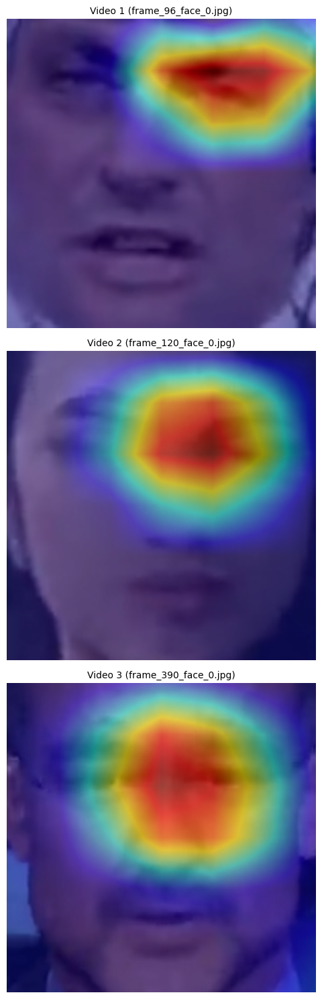

In [36]:


# Define input directories for the 3 different videos
input_dirs = [
    "D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/000_003",  # Input directory for video 1
    "D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/001_870",  # Input directory for video 2
    "D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/002_006"   # Input directory for video 3
]
# Apply GradCAM++ for this model on 3 different videos
apply_gradcam_pp_tfvis(model_lqdf.get_layer("spatial_feature_extractor"), target_layer="conv5_block3_3_conv", input_dirs=input_dirs,target_size=(224, 224), max_images=1)

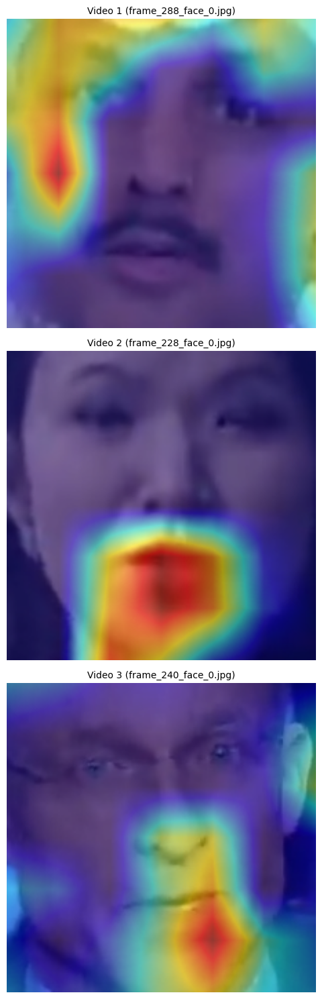

In [42]:
input_dirs = [
    "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/000_003",  # Input directory for video 1
    "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/001_870",  # Input directory for video 2
    "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/002_006"   # Input directory for video 3
]
# Apply GradCAM++ for this model on 3 different videos
apply_gradcam_pp_tfvis(model_lqff.get_layer("spatial_feature_extractor"), target_layer="conv5_block3_3_conv", input_dirs=input_dirs,target_size=(224, 224), max_images=1)

In [41]:
model_lqfs = load_model("C:/codes/projects/SIH-2024/DeepFake/DeepFake/Face-Swap-Detection-Model/Models/LQ/FS/lq_model_fs_acc_9272_220225.h5")

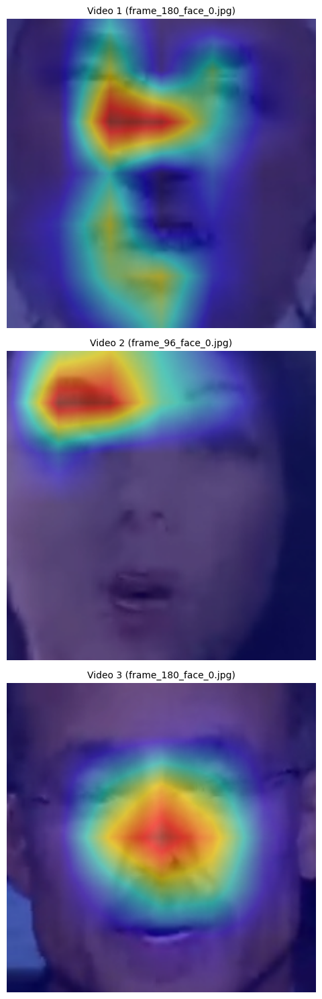

In [43]:
input_dirs = [
    "D:/Projects/Face-Swap-Detection-Model/X_Data/fs_lq_2/facial/000_003",  # Input directory for video 1
    "D:/Projects/Face-Swap-Detection-Model/X_Data/fs_lq_2/facial/001_870",  # Input directory for video 2
    "D:/Projects/Face-Swap-Detection-Model/X_Data/fs_lq_2/facial/002_006"   # Input directory for video 3
]
# Apply GradCAM++ for this model on 3 different videos
apply_gradcam_pp_tfvis(model_lqfs.get_layer("spatial_feature_extractor"), target_layer="conv5_block3_3_conv", input_dirs=input_dirs,target_size=(224, 224), max_images=1)

In [44]:
model_lqnt = load_model("C:/codes/projects/SIH-2024/DeepFake/DeepFake/Face-Swap-Detection-Model/Models/LQ/NT/lq_model_nt_acc_6489_240225.h5")

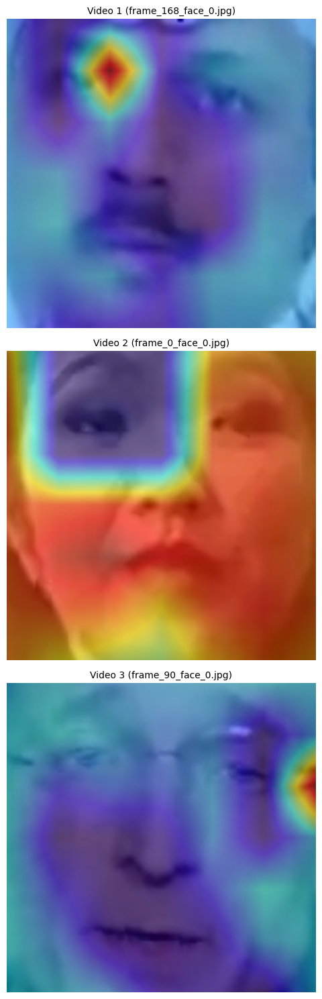

In [ ]:
input_dirs_nt = [
    "D:/Projects/Face-Swap-Detection-Model/X_Data/nt_lq/facial/000_003",  # Input directory for video 1
    "D:/Projects/Face-Swap-Detection-Model/X_Data/nt_lq/facial/001_870",  # Input directory for video 2
    "D:/Projects/Face-Swap-Detection-Model/X_Data/nt_lq/facial/002_006"   # Input directory for video 3
]
# Apply GradCAM++ for this model on 3 different videos
apply_gradcam_pp_tfvis(model_lqnt.get_layer("spatial_feature_extractor"), target_layer="conv5_block3_3_conv", input_dirs=input_dirs,target_size=(224, 224), max_images=1)

In [64]:
def combine_heatmaps_for_models(models, target_layer, input_dirs, target_size=(224, 224), max_images=1):
    """
    Combine heatmaps for 4 different models on 1 random frame from 3 different videos into a single plot
    with 4 columns (one for each model) and 3 rows (one for each video).
    
    Args:
        models (list): List of 4 models to apply GradCAM++.
        target_layer (str): The target layer to apply GradCAM++.
        input_dirs (2D list): A 2D list where each row represents directories for a specific model and contains directories of videos.
        target_size (tuple): The target size to resize images (default: (224, 224)).
        max_images (int): Maximum number of images per video (default: 1).
    """
    # Create a figure for the combined output (4 models, 3 videos)
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))

    # Loop through each model
    for model_idx, model in enumerate(models):
        # Loop through each video in the current model's directories
        for video_idx, video_dir in enumerate(input_dirs[model_idx]):
            # Get the heatmap images for the current video and model
            heatmap_images = apply_gradcam_pp_tfvis(model, target_layer, [video_dir], target_size, max_images)
            
            # Ensure the heatmap_images is not None or empty
            if heatmap_images:
                # Plot the result for this video and model
                axes[video_idx, model_idx].imshow(heatmap_images[0])  # Assume single image output
                axes[video_idx, model_idx].set_title(f"Dataset {model_idx + 1} - Video {video_idx + 1}", fontsize=10)
                axes[video_idx, model_idx].axis('off')
            else:
                axes[video_idx, model_idx].axis('off')

    # Adjust layout and display the combined figure
    plt.tight_layout()
    plt.show()


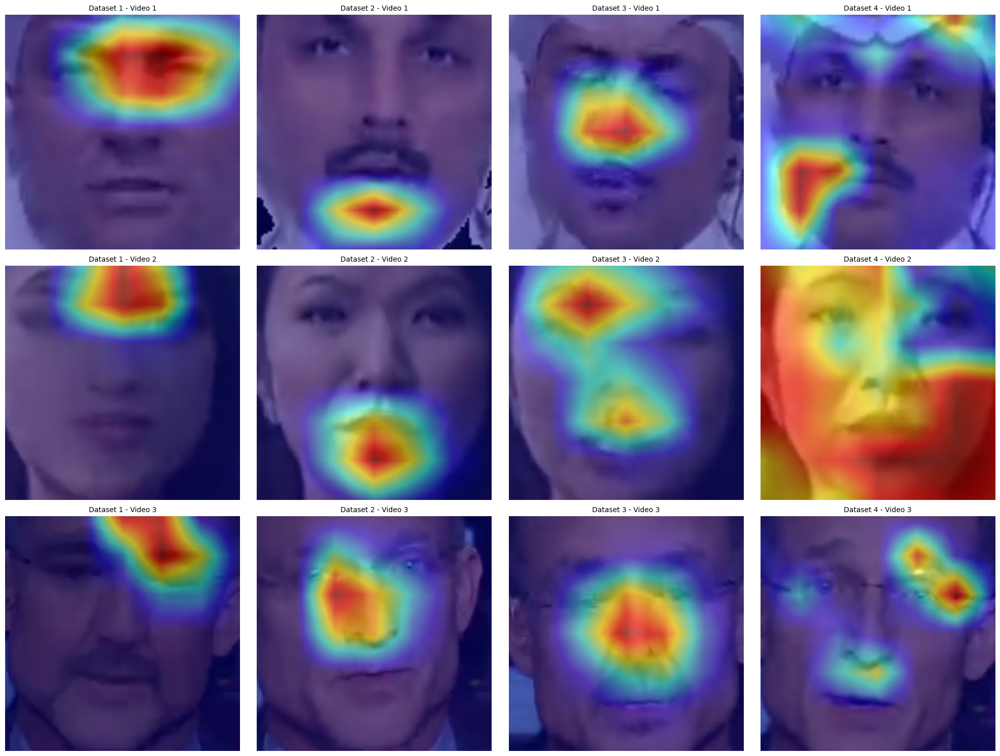

In [65]:
models = [model_lqdf.get_layer("spatial_feature_extractor"), model_lqff.get_layer("spatial_feature_extractor"), model_lqfs.get_layer("spatial_feature_extractor"), model_lqnt.get_layer("spatial_feature_extractor")]

# Define the target layer for each model (e.g., the last convolutional layer)
target_layer = 'conv5_block3_3_conv'  # Example layer, you should set it to the correct one

# Define input directories for each model (3 videos per model)
input_dirs = [
    [
        "D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/000_003",  # Input directory for video 1
        "D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/001_870",  # Input directory for video 2
        "D:/Projects/Face-Swap-Detection-Model/X_Data/df_lq/facial/002_006"   # Input directory for video 3
    ],

    [
        "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/000_003",  # Input directory for video 1
        "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/001_870",  # Input directory for video 2
        "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f_lq/facial/002_006"   # Input directory for video 3
    ],

    [
        "D:/Projects/Face-Swap-Detection-Model/X_Data/fs_lq_2/facial/000_003",  # Input directory for video 1
        "D:/Projects/Face-Swap-Detection-Model/X_Data/fs_lq_2/facial/001_870",  # Input directory for video 2
        "D:/Projects/Face-Swap-Detection-Model/X_Data/fs_lq_2/facial/002_006"   # Input directory for video 3
    ],

    [
        "D:/Projects/Face-Swap-Detection-Model/X_Data/nt_lq/facial/000_003",  # Input directory for video 1
        "D:/Projects/Face-Swap-Detection-Model/X_Data/nt_lq/facial/001_870",  # Input directory for video 2
        "D:/Projects/Face-Swap-Detection-Model/X_Data/nt_lq/facial/002_006"   # Input directory for video 3
    ]
]

# Call the new function to combine heatmaps for all 4 models
combine_heatmaps_for_models(models, target_layer, input_dirs, target_size=(224, 224), max_images=1)


In [57]:
model_df = load_model("model_df_acc_9703_051224.h5")

In [60]:
model_f2f = load_model("model_f2f_acc_9624_230125.h5")

In [63]:
model_fs = load_model("model_fs_acc_9599_051224.h5")

In [66]:
model_nt = load_model("model_nt_acc_7704_240225.h5")

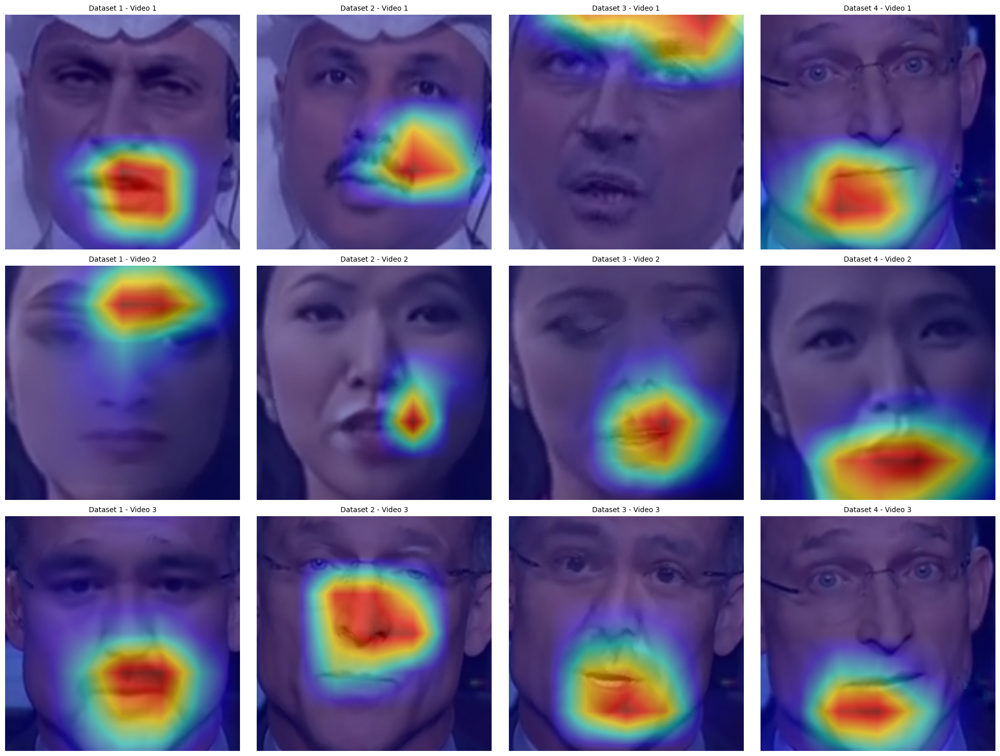

In [72]:
models = [model_df.get_layer("spatial_feature_extractor"), model_f2f.get_layer("spatial_feature_extractor"), model_fs.get_layer("spatial_feature_extractor"), model_nt.get_layer("spatial_feature_extractor")]

# Define the target layer for each model (e.g., the last convolutional layer)
target_layer = 'conv5_block3_3_conv'  # Example layer, you should set it to the correct one

# Define input directories for each model (3 videos per model)
input_dirs = [
    [
        "F:/X_Data/df2/facial/000_003",  # Input directory for video 1
        "F:/X_Data/df2/facial/001_870",  # Input directory for video 2
        "F:/X_Data/df2/facial/002_006"   # Input directory for video 3
    ],

    [
        "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f/facial/000_003",  # Input directory for video 1
        "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f/facial/001_870",  # Input directory for video 2
        "D:/Projects/Face-Swap-Detection-Model/X_Data/f2f/facial/002_006"   # Input directory for video 3
    ],

    [
        "D:/Projects/Face-Swap-Detection-Model/X_Data/fs/facial/000_003",  # Input directory for video 1
        "D:/Projects/Face-Swap-Detection-Model/X_Data/fs/facial/001_870",  # Input directory for video 2
        "D:/Projects/Face-Swap-Detection-Model/X_Data/fs/facial/002_006"   # Input directory for video 3
    ],

    [
        "F:/X_Data/nt/facial/002_006",  # Input directory for video 1
        "F:/X_Data/nt/facial/001_870",  # Input directory for video 2
        "F:/X_Data/nt/facial/002_006"   # Input directory for video 3
    ]
]

# Call the new function to combine heatmaps for all 4 models
combine_heatmaps_for_models(models, target_layer, input_dirs, target_size=(224, 224), max_images=1)
